<a href="https://colab.research.google.com/github/evangriffiths45/BirdCoding/blob/main/NOBOID.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# This installs opensoundscape library. For every new session a new install is required.
# WHEN IT ASKS TO RESTART THE SESSION, CANCEL IT.
%pip install opensoundscape

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.4/130.4 kB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 64.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 817.9/817.9 kB 65.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.4/383.4 kB 46.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 25.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 107.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 112.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 309.3/309.3 kB 40.8 MB/s eta 0:00:00
     ━━

In [ ]:
# Import required libraries
from opensoundscape import Audio, Spectrogram
from opensoundscape.annotations import BoxedAnnotations
import numpy as np
import pandas as pd
from glob import glob
from pathlib import Path
from matplotlib import pyplot as plt
import os
import re
from google.colab import drive
import random
import sklearn
from opensoundscape import CNN


In [ ]:
# Mount your google drive account so that you can access data from it(It also includes shared drives )
drive.mount('/content/drive')

# Run below line to view all files in the given path
#!ls "/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/"

base_path = '/content/drive/Shared drives/Audiomoth/data/Selection Tables' # This is the base path for the selection tables
folder_name = 'Summer Calls/2022/Chino 004' # Choose the folder accordingly( Fall, Summer )

# Construct the relative path
relative_folder_path = os.path.join(base_path, folder_name) # This joins the base path and the folder path which we want into a single path

Mounted at /content/drive


In [ ]:
# Loads all the file names at the loaction into the "folder" variable
folder = glob(os.path.join(relative_folder_path, "*"))

audio_files = []
selection_files = []

# Separate the audio and selection files
for file in folder:
    #print(file)
    if file.endswith('.wav') or file.endswith('.WAV'):
        audio_files.append(file)
    elif file.endswith('.txt') or file.endswith('.TXT'):
        selection_files.append(file)

# Remove files that don't have corresponding patterns
audio_files_filtered = []
selection_files_filtered = []

for audio_file in audio_files:
    prefix = audio_file.split('_')[0]
    for selection_file in selection_files:
        if selection_file.startswith(prefix):
            audio_files_filtered.append(audio_file)
            selection_files_filtered.append(selection_file)
            break

audio_files = audio_files_filtered
selection_files = selection_files_filtered

# Sort the file names so that both audio files and selection files are in the same order
audio_files=sorted(audio_files, key=lambda x: x.split('_')[0])
selection_files = sorted(selection_files, key=lambda x: x.split('_')[0])

for audio_file in audio_files:
  print(audio_file)
for selection_file in selection_files:
  print(selection_file)

/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220629_063500_004_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220630_063500_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220701_063500.WAV
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220702_063500_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220704_063500_004_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220705_063500_clipped.wav
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220706_063500.WAV
/content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Call

In [ ]:
# Creates BoxedAnnotations object from Raven selection files and corresponding audio files
annotations = BoxedAnnotations.from_raven_files(selection_files, audio_files)

# Rename the 'annotation' column to 'length'
annotations.df.rename(columns={'annotation': 'length'}, inplace=True)

# Rename the 'Annotation' column to 'annotation'
annotations.df.rename(columns={'Annotation': 'annotation'}, inplace=True)

In [ ]:
# Defines parameters for creating one-hot encoded clip labels
clip_duration = 1  # Duration of each clip in seconds
clip_overlap = 0.5  # Overlap between consecutive clips in seconds
min_label_overlap = 0.1  # Minimum overlap required with a label for a clip to be considered positive
species_of_interest = ["NOBO"]  # List of species for which to create one-hot encoded labels

# Creates one-hot encoded clip labels DataFrame using annotations
labels_df = annotations.one_hot_clip_labels(
    clip_duration=clip_duration,
    clip_overlap=clip_overlap,
    min_label_overlap=min_label_overlap,
    class_subset=species_of_interest  # Specify the species of interest to include in the labels
)

# Prints the resulting DataFrame containing one-hot encoded clip labels
print(labels_df)


                                                                        NOBO
file                                               start_time end_time      
/content/drive/Shared drives/Audiomoth/data/Sel... 0.0        1.0        0.0
                                                   0.5        1.5        0.0
                                                   1.0        2.0        0.0
                                                   1.5        2.5        0.0
                                                   2.0        3.0        0.0
...                                                                      ...
/content/drive/Shared drives/Audiomoth/data/Sel... 597.0      598.0      0.0
                                                   597.5      598.5      0.0
                                                   598.0      599.0      0.0
                                                   598.5      599.5      0.0
                                                   599.0      600.0      0.0

In [ ]:
%%capture --no-stdout --no-display
while True:
  # This loop runs until we get optimal number of positives in train and test sets
  # Randomly select 20% of the files for the test set
  random_files = random.sample(selection_files, int(float(len(selection_files)) * 0.2))

  # Remove '.txt' extension from file names
  l = [str(file).rsplit('/', 1)[-1][:8] for file in random_files]

  # Create a mask to filter the test set from the labels DataFrame
  mask = labels_df.reset_index()['file'].apply(lambda x: any(file_name in x for file_name in l)).values

  # Filter out the test set and create train and validation sets
  test_set = labels_df[mask]
  train_and_val_set = labels_df.drop(test_set.index)

  train_df, valid_df = sklearn.model_selection.train_test_split(train_and_val_set, test_size=0.1, random_state=0)

  train_positives=train_df[train_and_val_set["NOBO"]==1].value_counts()
  test_positives = test_set[test_set["NOBO"]==1].value_counts()
  total_positives = labels_df[labels_df["NOBO"]==1].value_counts()

  if train_positives[1]/total_positives[1] <= .73 and train_positives[1]/total_positives[1] > .7 and test_positives[1]/total_positives[1] <= .2 and test_positives[1]/total_positives[1] > .18:
    break


# Save train and validation sets and test set to CSV files
train_and_val_set.to_csv("/content/drive/My Drive/train_and_val_set.csv")
test_set.to_csv("/content/drive/My Drive/test_set.csv")

# Save the training set as a CSV file
train_df.to_csv("/content/drive/My Drive/train_set.csv")

# Save the validation set as a CSV file
valid_df.to_csv("/content/drive/My Drive/valid_set.csv")

print("Train Positives =",train_positives[1],";","Test Positives =",test_positives[1])

Train Positives = 2062 ; Test Positives = 557


In [ ]:
# Read train and validation sets and test set from CSV files
# RUN BELOW CODE WHEN THE TRAIN, VALID AND TEST DATAFRAMES ARE LOST
train_and_val_set = pd.read_csv('/content/drive/My Drive/train_and_val_set.csv', index_col=[0, 1, 2])
test_set = pd.read_csv('/content/drive/My Drive/test_set.csv', index_col=[0, 1, 2])
train_df = pd.read_csv("/content/drive/My Drive/train_set.csv", index_col=[0, 1, 2])
valid_df = pd.read_csv("/content/drive/My Drive/valid_set.csv", index_col=[0, 1, 2])


In [ ]:
# Randomly shuffle the rows of train_df
train_df = train_df.sample(frac=1)

# Randomly shuffle the rows of valid_df
valid_df = valid_df.sample(frac=1)

# Print the shuffled train_df
print(train_df)

# Print the shuffled valid_df
print(valid_df)

                                                                        NOBO
file                                               start_time end_time      
/content/drive/Shared drives/Audiomoth/data/Sel... 282.5      283.5      0.0
/content/drive/Shared drives/Audiomoth/data/Sel... 63.0       64.0       1.0
/content/drive/Shared drives/Audiomoth/data/Sel... 37.5       38.5       0.0
/content/drive/Shared drives/Audiomoth/data/Sel... 479.0      480.0      0.0
/content/drive/Shared drives/Audiomoth/data/Sel... 453.0      454.0      0.0
...                                                                      ...
/content/drive/Shared drives/Audiomoth/data/Sel... 252.0      253.0      1.0
/content/drive/Shared drives/Audiomoth/data/Sel... 436.0      437.0      0.0
/content/drive/Shared drives/Audiomoth/data/Sel... 508.0      509.0      1.0
/content/drive/Shared drives/Audiomoth/data/Sel... 594.0      595.0      0.0
/content/drive/Shared drives/Audiomoth/data/Sel... 371.5      372.5      0.0

In [ ]:
# Use resnet34 architecture
architecture = 'resnet34'

# Can use this code to get your classes, if needed
# Retrieve the list of classes from the columns of the train_df DataFrame
class_list = list(train_df.columns)

# Initialize a CNN model with the specified architecture, classes, and sample duration
model = CNN(
    architecture=architecture,      # Architecture of the CNN model
    classes=class_list,             # List of classes for classification
    sample_duration=clip_duration  # Duration of audio clips used for training
)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 209MB/s]


In [ ]:
# Define the folder path where model training checkpoints will be saved(THIS WILL CREATE A FOLDER IN YOUR GOOGLE DRIVE)
checkpoint_folder = Path("/content/drive/My Drive/model_training_checkpoints")

# Create the folder if it doesn't exist
checkpoint_folder.mkdir(exist_ok=True)

In [ ]:
# Gives on what the code is running(cpu,cuda...)
# THIS IS JUST FOR A CHECK
print(f'model.device is: {model.device}')

model.device is: cuda:0


In [ ]:
%%capture --no-stdout --no-display
from google.colab import output
output.enable_custom_widget_manager()

# Train the model
model.train(
    train_df,  # Training dataset
    valid_df,  # Validation dataset
    epochs=10,  # Number of epochs for training
    batch_size=64,  # Batch size
    log_interval=1000,  # Log progress every 100 batches
    num_workers=12,  # Number of parallelized CPU tasks for preprocessing
    save_interval=5,  # Save checkpoint every 5 epochs
    save_path=checkpoint_folder  # Location to save checkpoints
)



Training Epoch 0


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 0 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.700
	Most Recent Batch Loss: 0.700
Metrics:
	MAP: 0.636

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.866

Training Epoch 1


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 1 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.429
	Most Recent Batch Loss: 0.429
Metrics:
	MAP: 0.772

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.892

Training Epoch 2


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 2 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.287
	Most Recent Batch Loss: 0.287
Metrics:
	MAP: 0.789

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.882

Training Epoch 3


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 3 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.204
	Most Recent Batch Loss: 0.204
Metrics:
	MAP: 0.800

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.906

Training Epoch 4


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 4 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.161
	Most Recent Batch Loss: 0.161
Metrics:
	MAP: 0.802

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.910

Training Epoch 5


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 5 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.193
	Most Recent Batch Loss: 0.193
Metrics:
	MAP: 0.815

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.915

Training Epoch 6


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 6 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.161
	Most Recent Batch Loss: 0.161
Metrics:
	MAP: 0.828

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.926

Training Epoch 7


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 7 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.263
	Most Recent Batch Loss: 0.263
Metrics:
	MAP: 0.833

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.912

Training Epoch 8


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 8 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.080
	Most Recent Batch Loss: 0.080
Metrics:
	MAP: 0.843

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.929

Training Epoch 9


  0%|          | 0/203 [00:00<?, ?it/s]

Epoch: 9 [batch 0/203, 0.00%] 
	Epoch Running Average Loss: 0.059
	Most Recent Batch Loss: 0.059
Metrics:
	MAP: 0.835

Validation.


  0%|          | 0/23 [00:00<?, ?it/s]

Metrics:
	MAP: 0.931

Best Model Appears at Epoch 9 with Validation score 0.931.


In [ ]:
# Load a saved model
from opensoundscape import load_model
model=load_model("/content/drive/My Drive/model_training_checkpoints/best.model")

In [ ]:
# Generate predictions using the trained model on the test set
# Scores are the prediction values given by the model for a given test set(The range of the scores would be from 0 to 1 because the activation_layer is sigmoid)
scores = model.predict(test_set, activation_layer='sigmoid')

  0%|          | 0/2398 [00:00<?, ?it/s]

In [ ]:
# Insert a new column "present" with all values set to True
scores.insert(1, "Present", True)

# Display the first few rows of the DataFrame
scores.head()

<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()


NOBO  \
file                                               start_time end_time             
/content/drive/Shared drives/Audiomoth/data/Sel... 0.0        1.0       0.015523   
                                                   0.5        1.5       0.016237   
                                                   1.0        2.0       0.005055   
                                                   1.5        2.5       0.007107   
                                                   2.0        3.0       0.002477   

                                                                        Present  
file                                               start_time end_time           
/content/drive/Shared drives/Audiomoth/data/Sel... 0.0        1.0          True  
                                                   0.5        1.5          True  
                                                   1.0        2.0          True  
                                                   1.5        2.5          True  
                                                   2.0        3.0          True

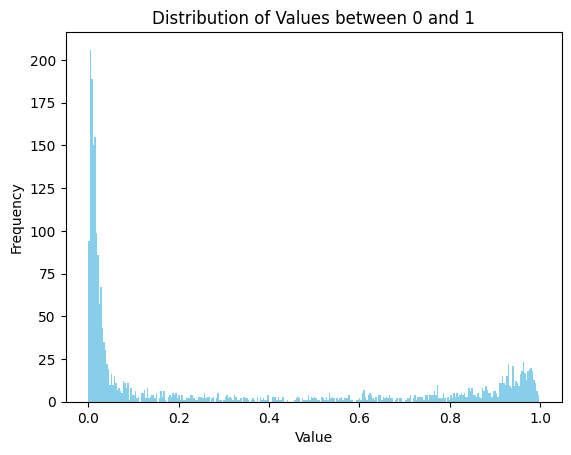

In [ ]:
# THIS PLOTS THE SCORES OF TEST DF( 0 to 1 )
plt.hist(scores['NOBO'], bins=300, color='skyblue')
plt.xlabel('Value')
plt.ylabel('Frequency')
#plt.xlim(0.75, 1)
#plt.ylim(0, 200)
#plt.xticks(np.arange(0.8, 1, 0.02))
plt.title('Distribution of Values between 0 and 1')
plt.show()

In [ ]:
# WE CLASSIFY EACH ROW EITHER POSITIVE OR NEGATIVE BY ASSIGNING 1 OR 0 TO THE PRESENT COLUMN OF THAT ROW
# Iterate through each row in the scores DataFrame
for index, row in scores.iterrows():
    # Check if the predicted score for the class 'NOBO' is greater than 0.5
    if row["NOBO"] > 0.5:
        # If the score is greater than 0.5, set the 'present' column value to 1
        scores.at[index, 'Present'] = 1
    else:
        # If the score is not greater than 0.5, set the 'present' column value to 0
        scores.at[index, 'Present'] = 0

# Display the first few rows of the scores DataFrame after updating the 'present' column
print(scores)

                                                                            NOBO  \
file                                               start_time end_time             
/content/drive/Shared drives/Audiomoth/data/Sel... 0.0        1.0       0.015523   
                                                   0.5        1.5       0.016237   
                                                   1.0        2.0       0.005055   
                                                   1.5        2.5       0.007107   
                                                   2.0        3.0       0.002477   
...                                                                          ...   
/content/drive/Shared drives/Audiomoth/data/Sel... 597.0      598.0     0.001418   
                                                   597.5      598.5     0.014799   
                                                   598.0      599.0     0.010299   
                                                   598.5      599.5     0.00

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 5.0 End Time: 6.0


<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()


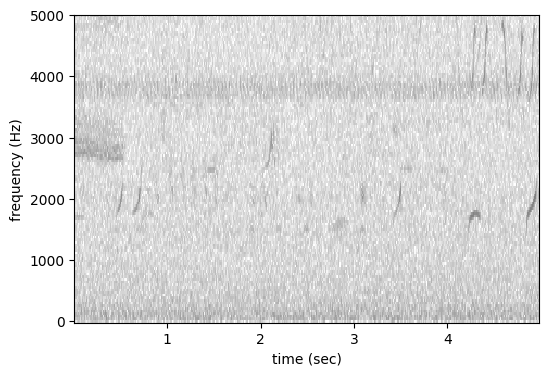

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 6.5 End Time: 7.5


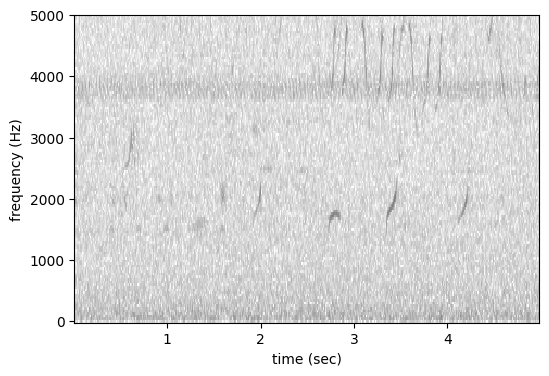

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 10.0 End Time: 11.0


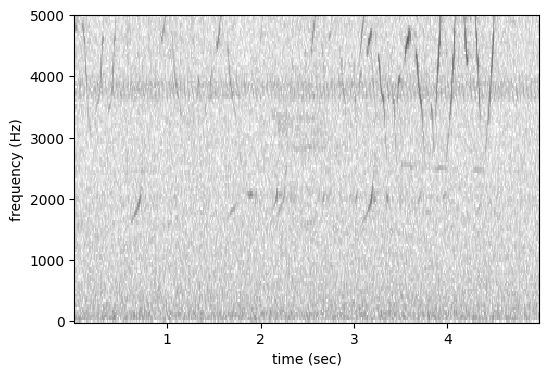

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 13.0 End Time: 14.0


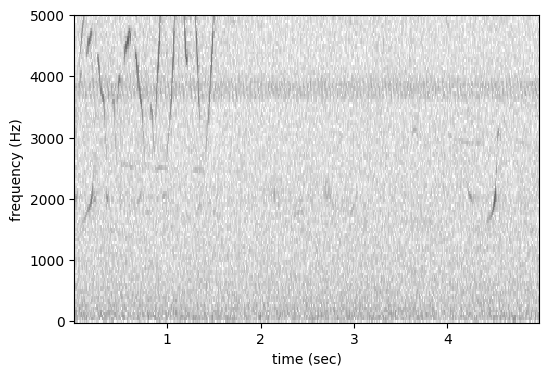

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 17.0 End Time: 18.0


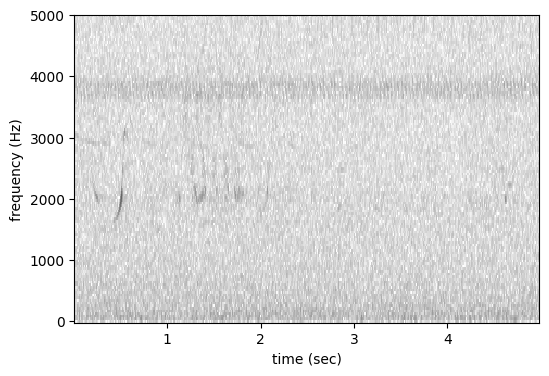

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 20.0 End Time: 21.0


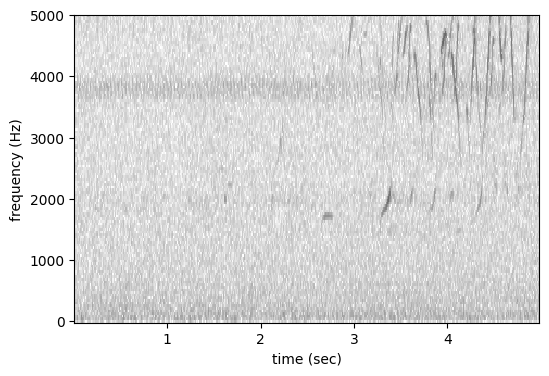

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 31.5 End Time: 32.5


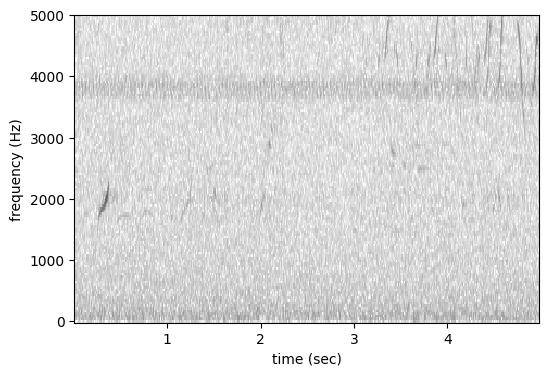

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 34.0 End Time: 35.0


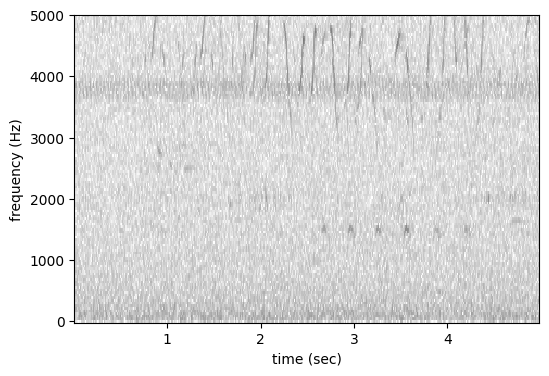

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 40.0 End Time: 41.0


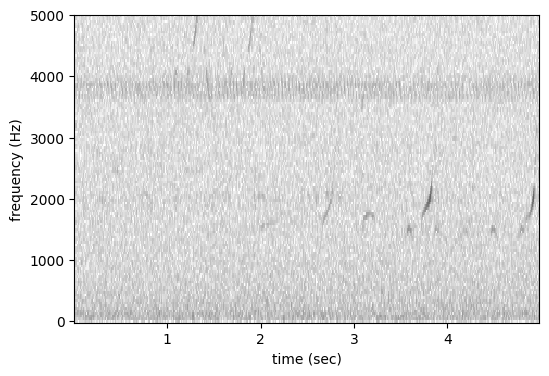

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 40.5 End Time: 41.5


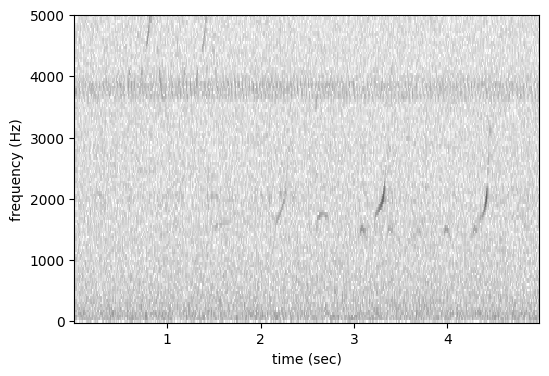

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 43.0 End Time: 44.0


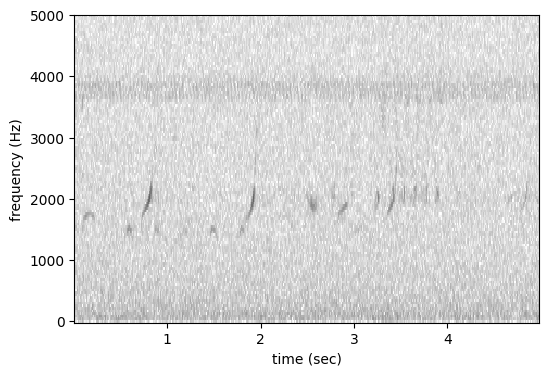

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 77.0 End Time: 78.0


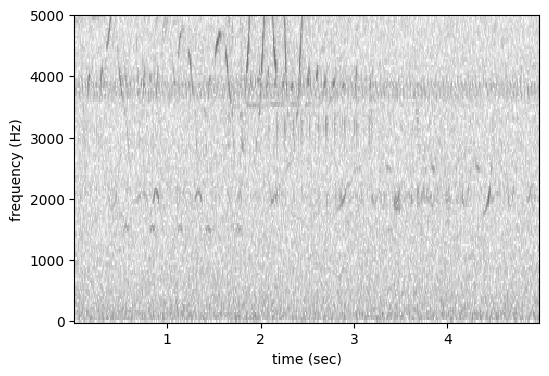

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 80.5 End Time: 81.5


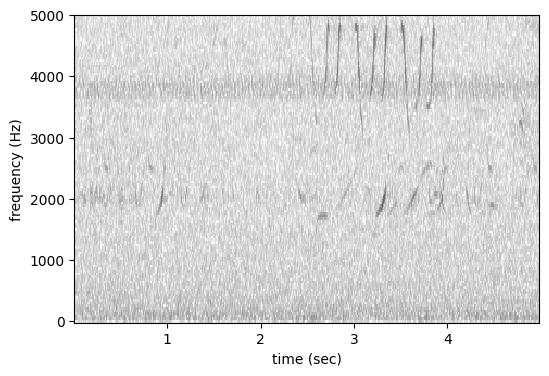

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 89.0 End Time: 90.0


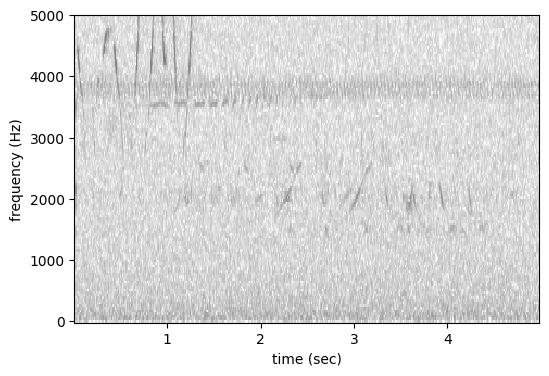

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 93.5 End Time: 94.5


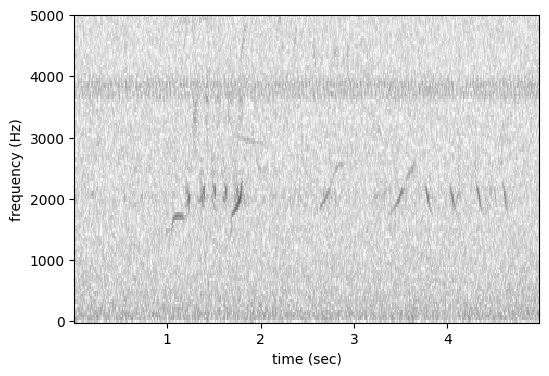

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 94.0 End Time: 95.0


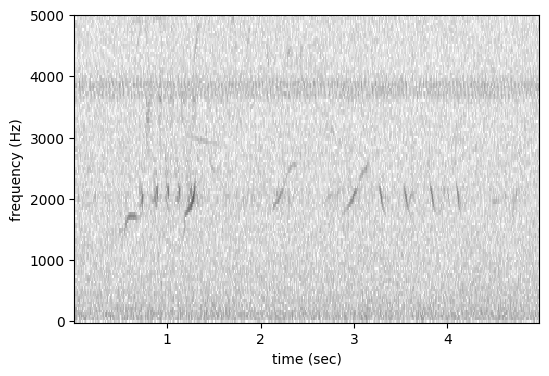

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 97.0 End Time: 98.0


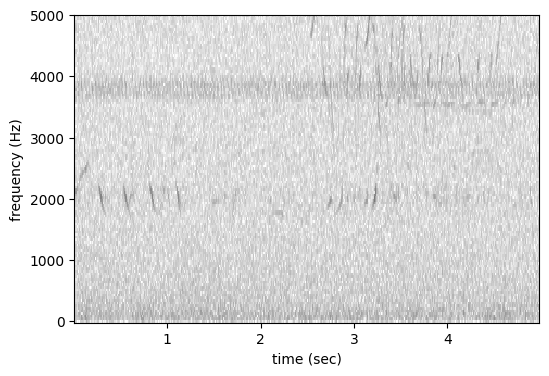

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 101.0 End Time: 102.0


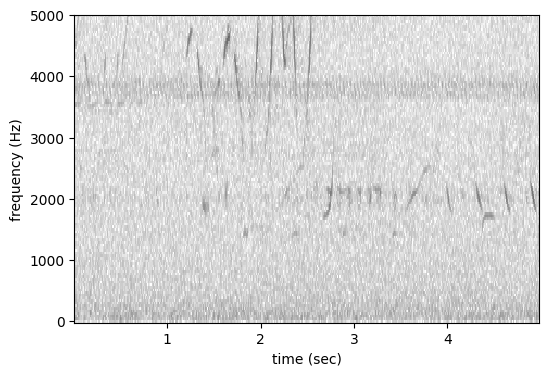

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 101.5 End Time: 102.5


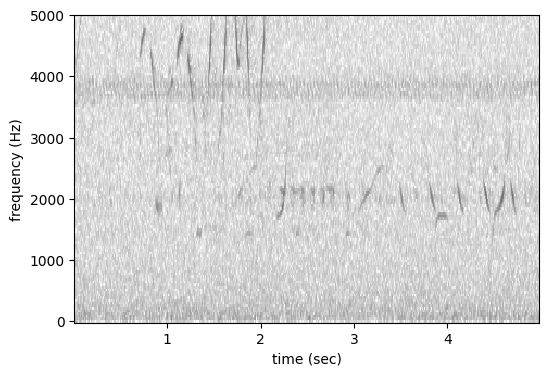

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 108.5 End Time: 109.5


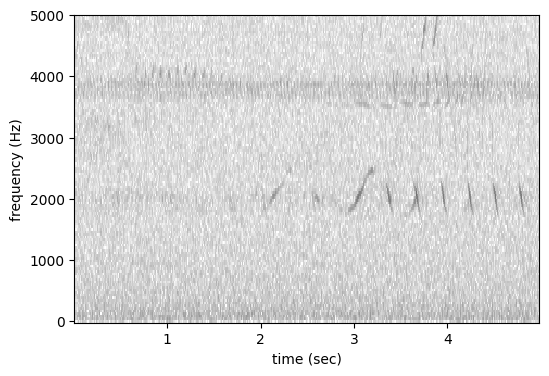

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 109.5 End Time: 110.5


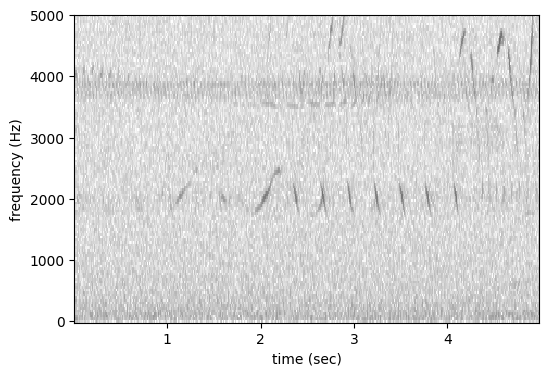

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 114.5 End Time: 115.5


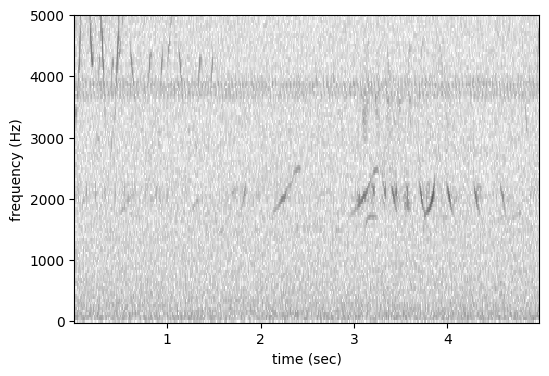

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 115.5 End Time: 116.5


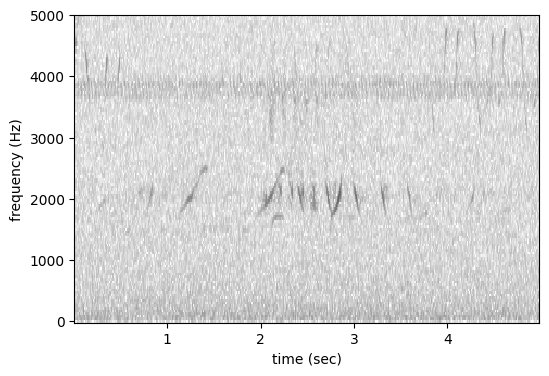

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 116.0 End Time: 117.0


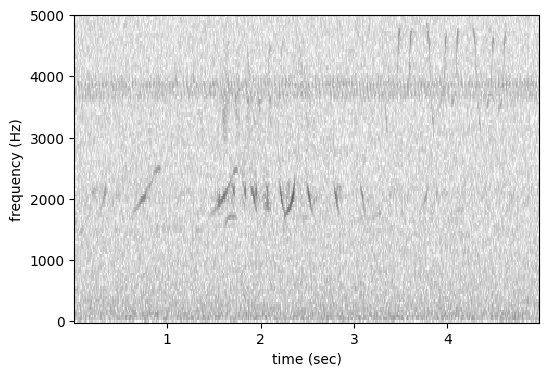

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 125.5 End Time: 126.5


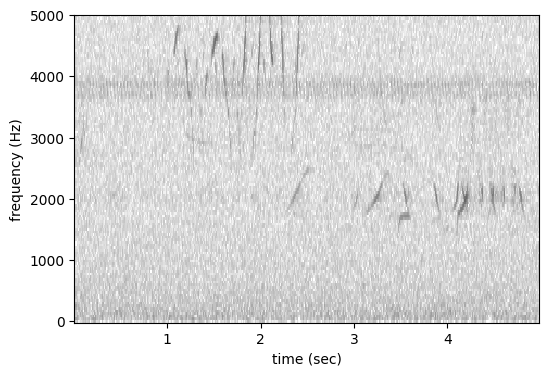

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 130.5 End Time: 131.5


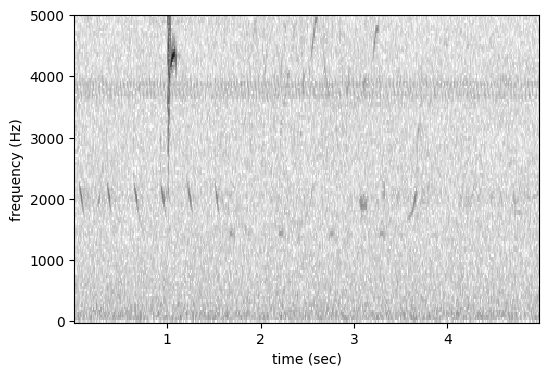

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 131.5 End Time: 132.5


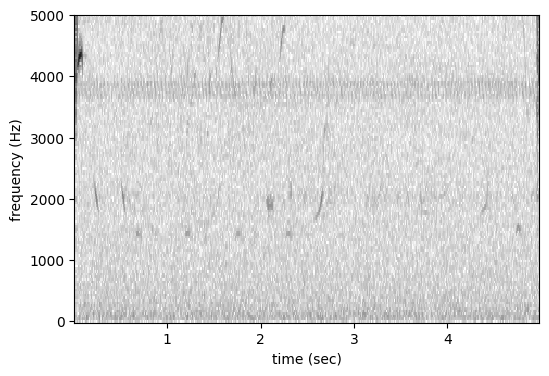

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 132.0 End Time: 133.0


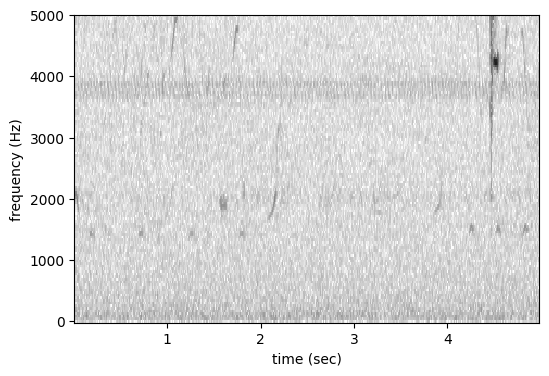

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 133.0 End Time: 134.0


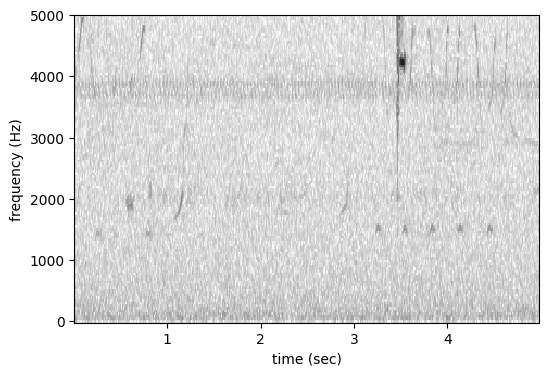

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 138.5 End Time: 139.5


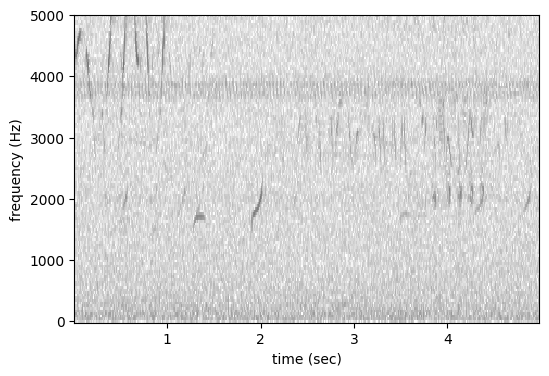

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 139.5 End Time: 140.5


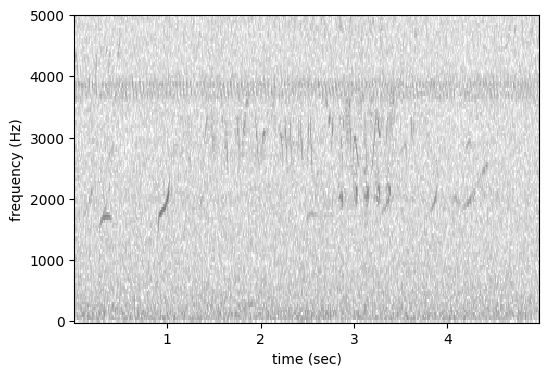

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 140.5 End Time: 141.5


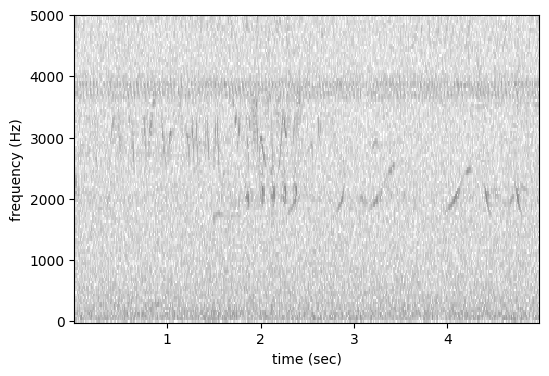

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 141.0 End Time: 142.0


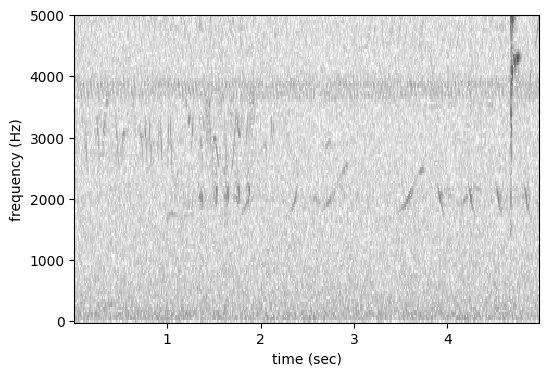

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 144.0 End Time: 145.0


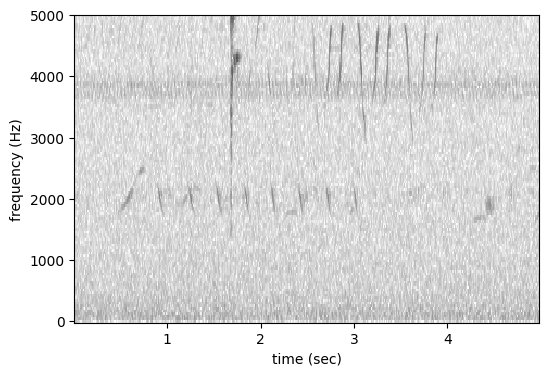

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 145.5 End Time: 146.5


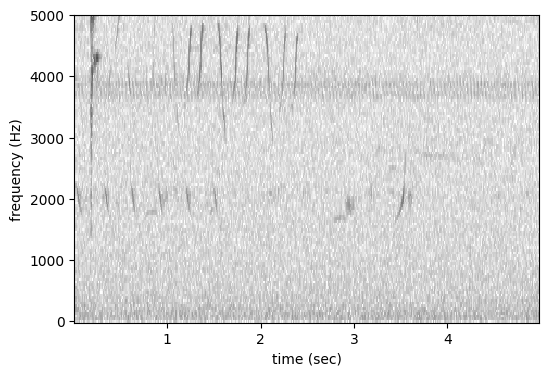

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 146.0 End Time: 147.0


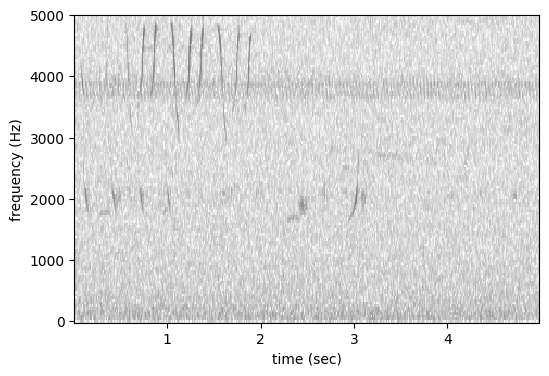

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 146.5 End Time: 147.5


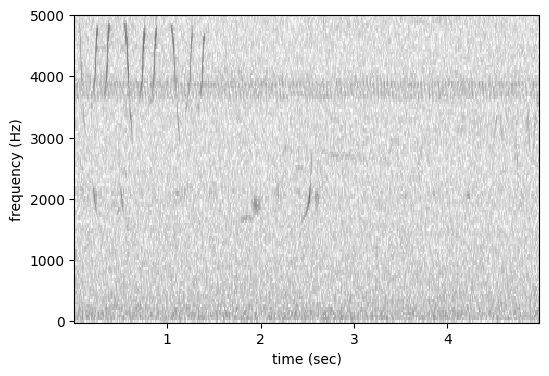

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 147.0 End Time: 148.0


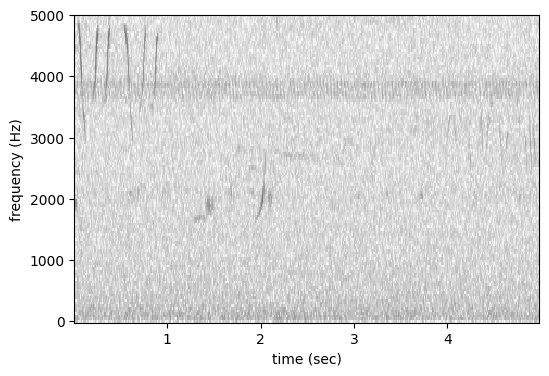

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 153.0 End Time: 154.0


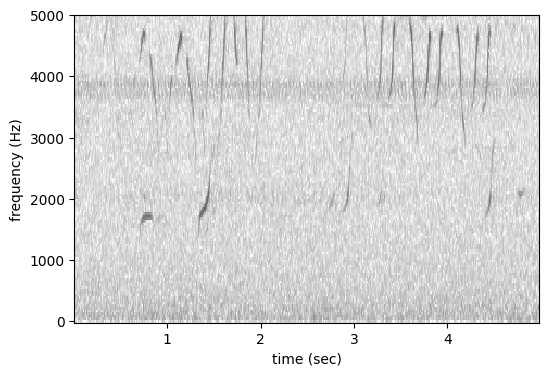

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 153.5 End Time: 154.5


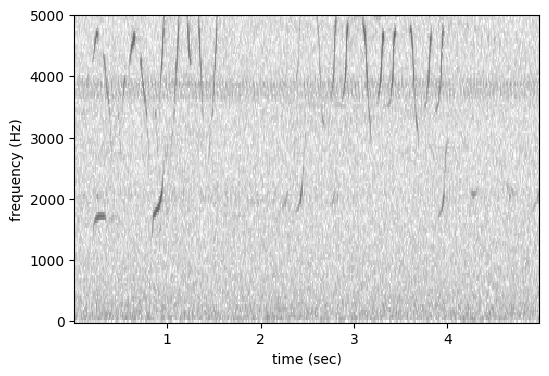

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 154.5 End Time: 155.5


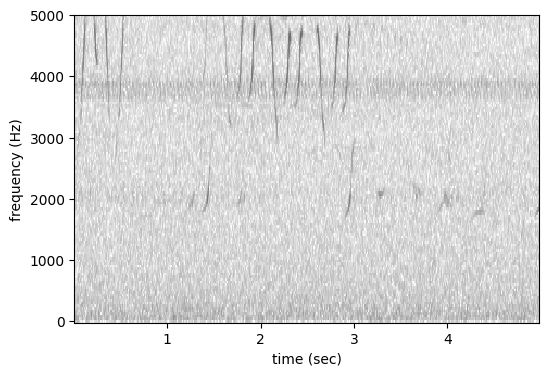

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 155.0 End Time: 156.0


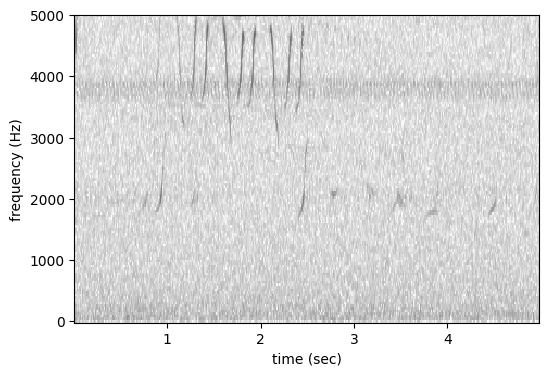

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 155.5 End Time: 156.5


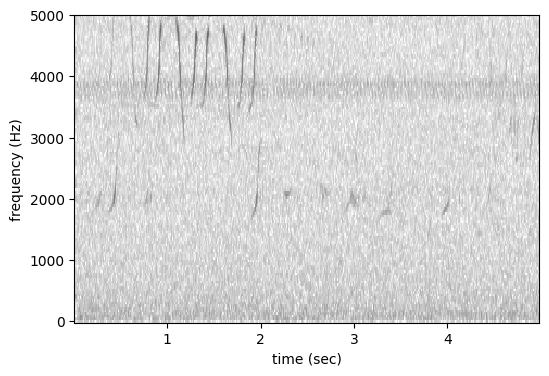

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 156.0 End Time: 157.0


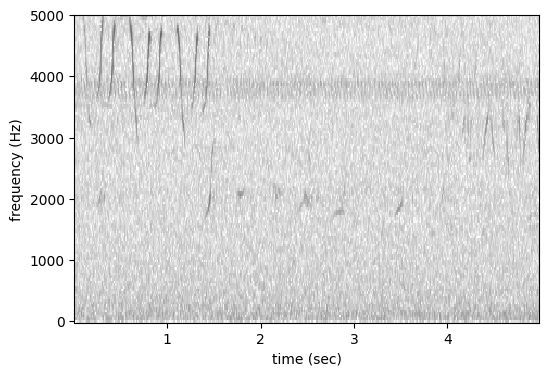

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 156.5 End Time: 157.5


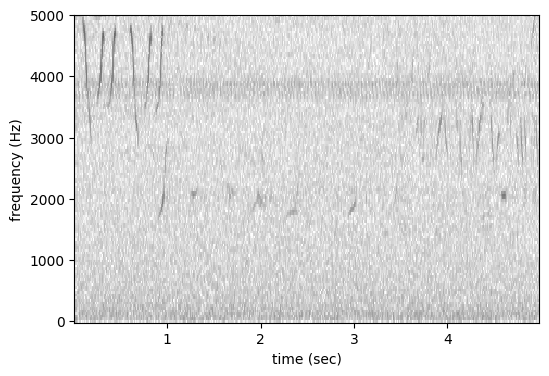

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 157.0 End Time: 158.0


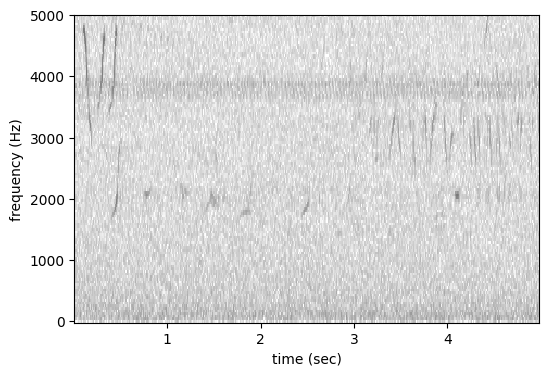

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 160.0 End Time: 161.0


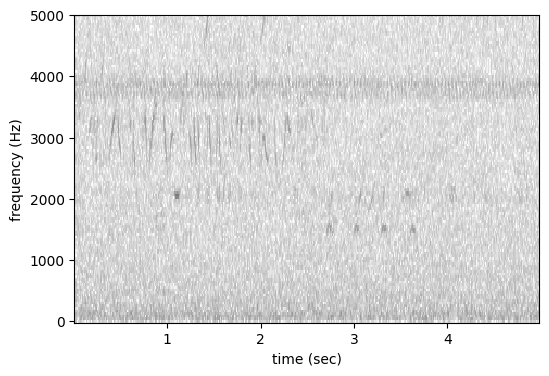

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 169.0 End Time: 170.0


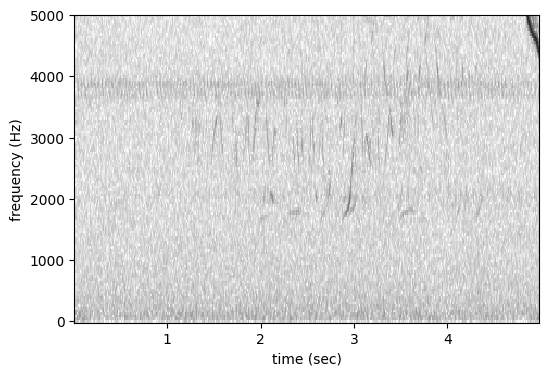

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 169.5 End Time: 170.5


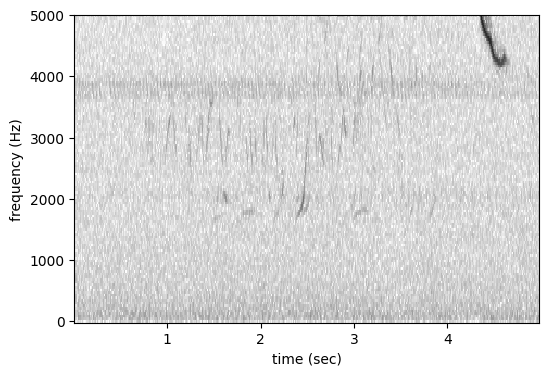

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 178.0 End Time: 179.0


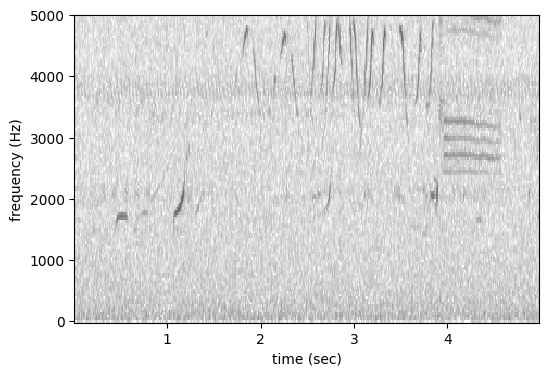

File: /content/drive/Shared drives/Audiomoth/data/Selection Tables/Summer Calls/2022/Chino 004/20220628_063500_clipped.wav 
Start Time: 178.5 End Time: 179.5


In [ ]:
# Initialize variables to count true positives (TP), true negatives (TN), false positives (FP), and false negatives (FN)
TP = 0
TN = 0
FP = 0
FN = 0

# Iterate through each row in the scores DataFrame
for index, row in scores.iterrows():
    # Check if the predicted value (present) is equal to the ground truth value (NOBO) and both are 1 (true positive)
    if row["Present"] == test_set.at[index,'NOBO'] == 1:
        TP += 1
        '''audio_object = Audio.from_file(index[0])
        trimmed = audio_object.resample(22000).trim(index[1],index[2])
        spectrogram_object = Spectrogram.from_audio(trimmed)
        spectrogram_object=spectrogram_object.bandpass(0,5000)
        trimmed.show_widget(normalize=True)
        print("File:", index[0],"\n" "Start Time:", index[1], "End Time:", index[2])
        fig= plt.subplots(figsize=(6, 4))  # Set the width to 8 inches and height to 4 inches
        spectrogram_object.plot()
        plt.show()'''
    # Check if the predicted value (present) is equal to the ground truth value (NOBO) and both are 0 (true negative)
    elif row["Present"] == test_set.at[index,'NOBO'] == 0:
        TN += 1
        '''audio_object = Audio.from_file(index[0])
        trimmed = audio_object.resample(22000).trim(index[1],index[2])
        spectrogram_object = Spectrogram.from_audio(trimmed)
        spectrogram_object=spectrogram_object.bandpass(0,5000)
        trimmed.show_widget(normalize=True)
        print("File:", index[0],"\n" "Start Time:", index[1], "End Time:", index[2])
        fig= plt.subplots(figsize=(6, 4))  # Set the width to 8 inches and height to 4 inches
        spectrogram_object.plot()
        plt.show()'''
    # Check if the predicted value is 1 (positive) while the ground truth value is 0 (false positive)
    elif row["Present"] == 1 and test_set.at[index,'NOBO'] == 0:
        FP += 1
        audio_object = Audio.from_file(index[0])
        trimmed = audio_object.resample(22000).trim(index[1]-2,index[2]+2)
        spectrogram_object = Spectrogram.from_audio(trimmed)
        spectrogram_object=spectrogram_object.bandpass(0,5000)
        #trimmed.show_widget(normalize=True)
        print("File:", index[0],"\n" "Start Time:", index[1], "End Time:", index[2])
        fig= plt.subplots(figsize=(6, 4))  # Set the width to 8 inches and height to 4 inches
        spectrogram_object.plot()
        plt.show()
    # Check if the predicted value is 0 (negative) while the ground truth value is 1 (false negative)
    elif row["Present"] == 0 and test_set.at[index,'NOBO'] == 1:
        FN += 1
        '''audio_object = Audio.from_file(index[0])
        trimmed = audio_object.resample(22000).trim(index[1],index[2])
        spectrogram_object = Spectrogram.from_audio(trimmed)
        spectrogram_object=spectrogram_object.bandpass(0,5000)
        trimmed.show_widget(normalize=True)
        print("File:", index[0],"\n" "Start Time:", index[1], "End Time:", index[2])
        fig= plt.subplots(figsize=(6, 4))  # Set the width to 8 inches and height to 4 inches
        spectrogram_object.plot()
        plt.show()'''

# Calculate accuracy, precision, recall, and F1 score
accuracy = (TP + TN) / (TP + TN + FP + FN)
precision = TP / (TP + FP)
recall = TP / (TP + FN)
f1_score = (2 * (precision * recall)) / (precision + recall)

# Create a confusion matrix
confusion_matrix = [[TP, FP], [FN, TN]]

# Print the metrics and confusion matrix
print("Accuracy =", accuracy)
print("Precision =", precision)
print("Recall =", recall)
print("F1 Score =", f1_score)
print("Confusion Matrix:", confusion_matrix)